# Part 1

In [1]:
using Pkg
Pkg.activate(".")

  Activating project at `c:\Users\skouf\Documents\2023\Semester 2\MATH2504\Assessment\Project3\Emmanuel-Skoufris-2504-2023-PROJECT3`

In [2]:
include("machine_learning_project.jl")

In [3]:
df = CSV.read(IOBuffer(read("data/housing_data.csv")), DataFrame);

## Task 1.1a

### `Rooms`

Rooms, Price, Method, Distance, and Landsize.

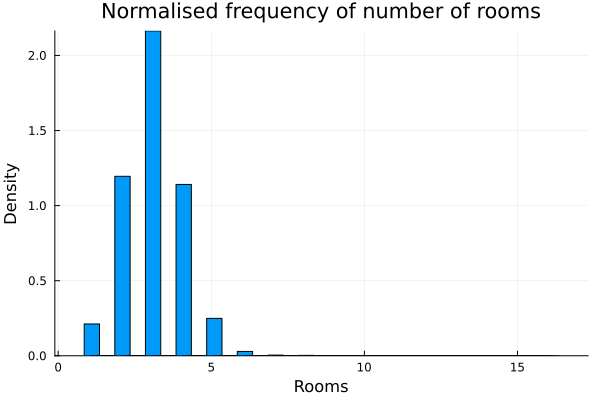

In [4]:
histogram(df.Rooms, 
          legend = false,  
          xlabel = "Rooms", 
          ylabel = "Density", 
          normed = true, 
          bar_width = 0.5,
          title = "Normalised frequency of number of rooms")

Notice that there are a few houses with 10 or more rooms, as seen below. 

In [31]:
df[df.Rooms .> 10, :]

Row,Suburb,Address,Rooms,Type,Price,Method,SellerG,Date,Distance,Postcode,Bedroom2,Bathroom,Car,Landsize,BuildingArea,YearBuilt,CouncilArea,Lattitude,Longtitude,Regionname,Propertycount
,String31,String31,Int64,String1,Int64?,String3,String31,String15,String7,String7,Int64?,Int64?,Int64?,Int64?,Float64?,Int64?,String31,Float64?,Float64?,String31,String7
1,Preston,12 Lyonsville Av,12,h,missing,SN,Barry,28/08/2016,8.8,3072,missing,missing,missing,missing,missing,missing,Darebin City Council,missing,missing,Northern Metropolitan,14577
2,Hawthorn,10 Berkeley St,12,h,4700000,PI,Property,20/05/2017,4.6,3122,missing,missing,missing,missing,missing,missing,Boroondara City Council,-37.8303,145.037,Southern Metropolitan,11308
3,Mitcham,20 Harrison St,16,h,5000000,S,Buxton,28/10/2017,17.2,3132,16,8,8,missing,missing,missing,Whitehorse City Council,-37.8141,145.199,Eastern Metropolitan,6871
4,Melton,213 Station Rd,12,h,710000,S,PRDNationwide,11/11/2017,31.7,3337,12,5,3,960,223.0,1970,Melton City Council,-37.6883,144.578,Western Victoria,3600


In [6]:
summarystats(df.Rooms)

Summary Stats:
Length:         34857
Missing Count:  0
Mean:           3.031012
Std. Deviation: 0.969933
Minimum:        1.000000
1st Quartile:   2.000000
Median:         3.000000
3rd Quartile:   4.000000
Maximum:        16.000000


### `Price`

There are some missing data for the variable `Price`, and as such the data have been filtered for missing values using the function `dropmissing()`.

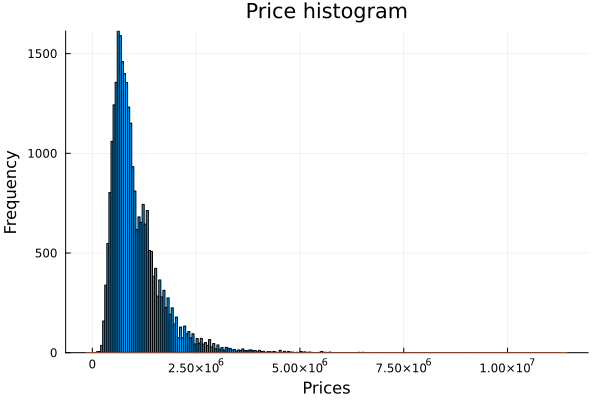

In [12]:
histogram(dropmissing(df, :Price).Price,  
          xlabel="Prices", 
          ylabel="Frequency", 
          title="Price histogram", 
          normed = false, 
          legend = false)
density!(dropmissing(df, :Price).Price) 

In [13]:
summarystats(dropmissing(df, :Price).Price)

Summary Stats:
Length:         27247
Missing Count:  0
Mean:           1050173.344955
Std. Deviation: 641467.130105
Minimum:        85000.000000
1st Quartile:   635000.000000
Median:         870000.000000
3rd Quartile:   1295000.000000
Maximum:        11200000.000000


### `Method`

In [25]:
counts_df = combine(groupby(df, :Method), nrow => :Count)

Row,Method,Count
,String3,Int64
1,SS,36
2,S,19744
3,VB,3108
4,SP,5095
5,PI,4850
6,SN,1317
7,W,173
8,PN,308
9,SA,226


In [40]:
plot(counts_df.Method, counts_df.Count, seriestype = :bar, xlabel = "Method", ylabel = "Count", legend = false)

### `Distance`

For the variable `Distance`, there is at least one row which contains the string `"#N/A"` as a value. This is removed below. 

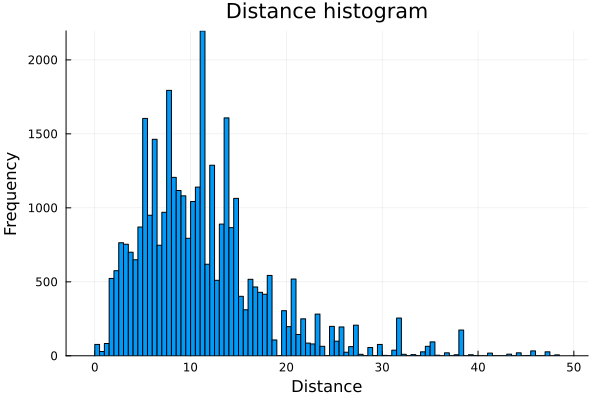

In [8]:
filtered_df = filter(row -> row.Distance ≠ "#N/A", df)
parseddata = parse.(Float64, dropmissing(filtered_df, :Distance).Distance)

histogram(parseddata,  
          xlabel="Distance", 
          ylabel="Frequency", 
          title="Distance histogram", 
          normed = false, 
          legend = false)

In [42]:
summarystats(parseddata)

Summary Stats:
Length:         34856
Missing Count:  0
Mean:           11.184929
Std. Deviation: 6.788892
Minimum:        0.000000
1st Quartile:   6.400000
Median:         10.300000
3rd Quartile:   14.000000
Maximum:        48.100000


### `Landsize`

In [43]:
histogram(df.Landsize,  
          xlabel="Distance", 
          ylabel="Frequency", 
          title="Distance histogram", 
          normed = false, 
          legend = false)

## Task 1.2a

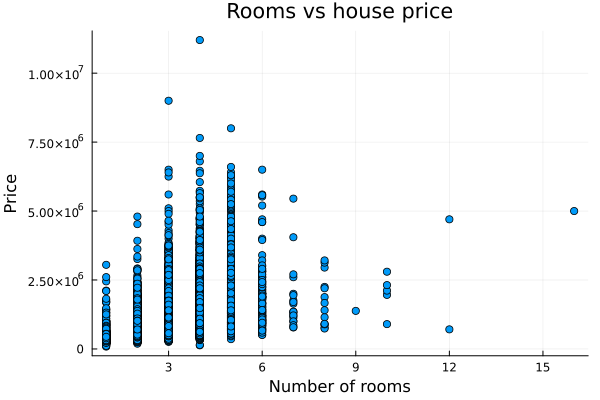

In [22]:
scatter(df.Rooms, 
        df.Price, 
        legend = false,
        xlabel = "Number of rooms",
        ylabel = "Price",
        title = "Rooms vs house price")

There seems to be a very slight positive relationship between `Rooms` and `Price`.

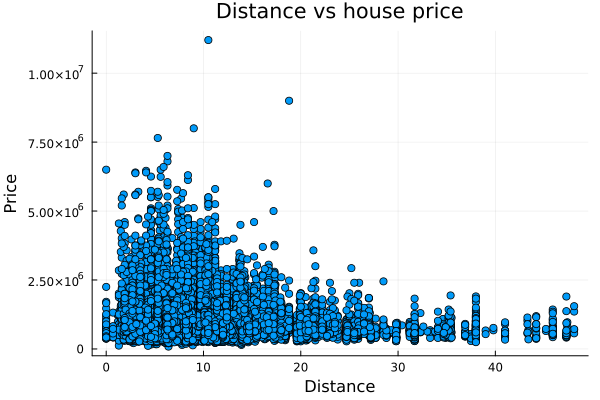

In [23]:
scatter(parseddata, 
        df.Price, 
        legend = false,
        xlabel = "Distance",
        ylabel = "Price",
        title = "Distance vs house price")

There seems to be a slight negative relationship between `Distance` and `Price`.

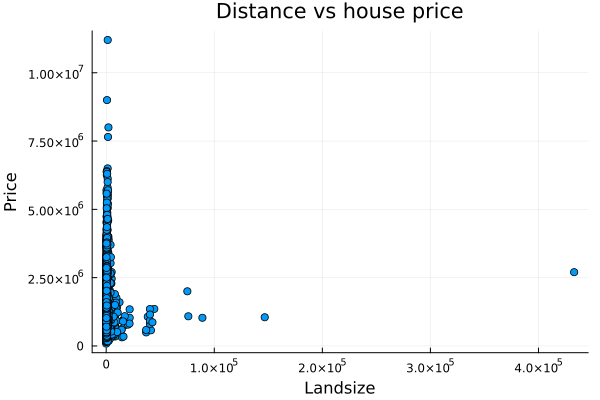

In [21]:
scatter(df.Landsize, 
        df.Price, 
        legend = false,
        xlabel = "Landsize",
        ylabel = "Price",
        title = "Landsize vs house price")

There doesn't seem to be a definitive relationship between `Landsize` and `Price`.

## Task 1.3a

In [101]:
date_df = combine(groupby(df, :Date), nrow => :Count);

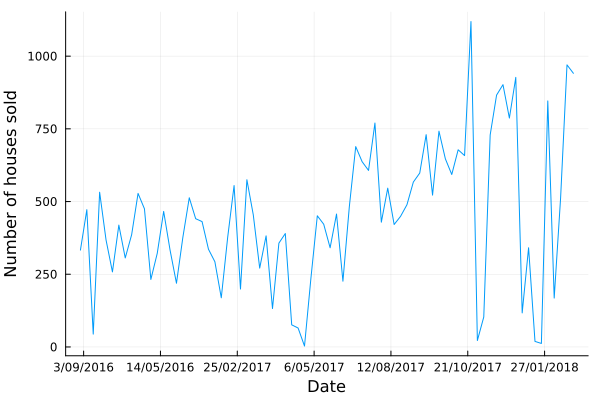

In [80]:
plot(date_df.Date, 
        date_df.Count, 
        legend = false, 
        xticks = (1:12:78, date_df.Date[1:12:78]),
        xlabel = "Date",
        ylabel = "Number of houses sold")

In [89]:
average_prices = []

cleaned_data = dropmissing(df, :Price)

for date in date_df.Date
    push!(average_prices, mean(cleaned_data[cleaned_data.Date .== date, :].Price))
end 

average_prices;

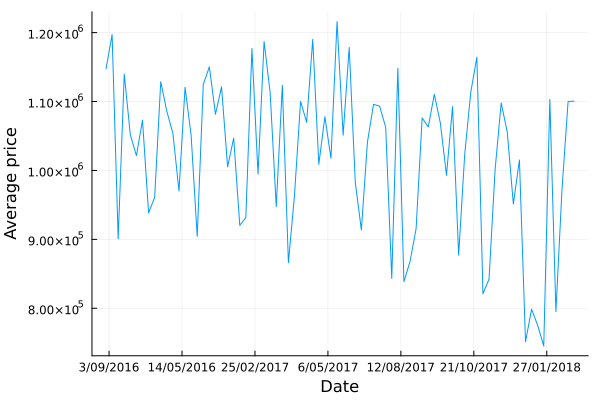

In [90]:
plot(date_df.Date, 
        average_prices, 
        legend = false, 
        xticks = (1:12:78, date_df.Date[1:12:78]),
        xlabel = "Date",
        ylabel = "Average price")

In [100]:
average_proportion = []

cleaned_data = dropmissing(df, :Type)

for date in date_df.Date
    types = cleaned_data[cleaned_data.Date .== date, :].Type
    i = 0 
    for type in types
        (type == "h") && (i += 1) 
    end 
    push!(average_proportion, i/length(types))
end 

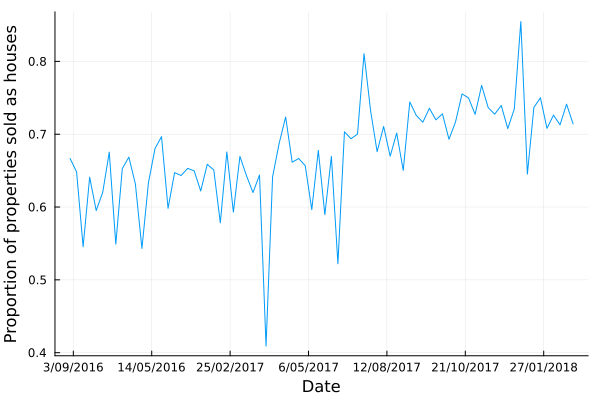

In [99]:
plot(date_df.Date, 
        average_proportion, 
        legend = false, 
        xticks = (1:12:78, date_df.Date[1:12:78]),
        xlabel = "Date",
        ylabel = "Proportion of properties sold as houses")

## Task 1.4a

In [ ]:
glm(@formula(ChanceofAdmit ~ GREScore), df_train, Binomial(), LogitLink())